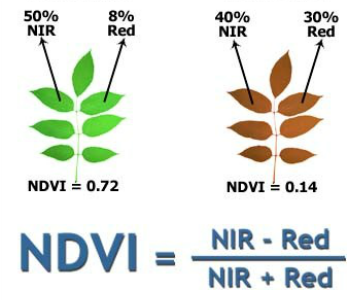

In [2]:
import requests
ip = "128.110.223.33" # IP where the system is deployed 
url=f'http://{ip}:81/avg/ndvi' # endpoint URL
computationURL=f'http://{ip}' # URL of Dask Gateway
nodes=5 # number of worker nodes in cluster 
cores=4 # number of cores per each worker node
ram=8 # size of memory of each worker node
cmap="RdYlGn" # colormap
dataRepositoryURL='https://earth-search.aws.element84.com/v0/' # URL of the data repository
date_range = '2022-03-01/2023-03-01' # interested date range

# coordintaes of the area of interest
coordinates = [[[44.65414676486739,40.76857928630406],[44.65414676486739,40.484598051914105],[45.08818157619223,40.484598051914105],[45.08818157619223,40.76857928630406],[44.65414676486739,40.76857928630406]]]

body={'computationURL': computationURL, 'nodes' : nodes, 'cores' : cores, 'ram' : ram, 'cmap': cmap, 'dataRepositoryURL':dataRepositoryURL, 'date_range': date_range, 'coords': {'type':'Polygon', 'coordinates': coordinates}}
response = requests.post(url, json = body)
response

In [2]:
from zipfile import ZipFile
from io import BytesIO

def unzip(response):
    zipfile = ZipFile(BytesIO(response.content))
    zipfile.extractall('./')
    zipfile.close()

unzip(response)

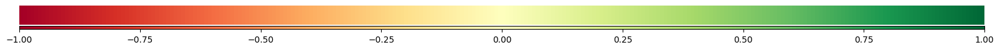

In [3]:
from util import visualize, show_legend
show_legend(cmap)


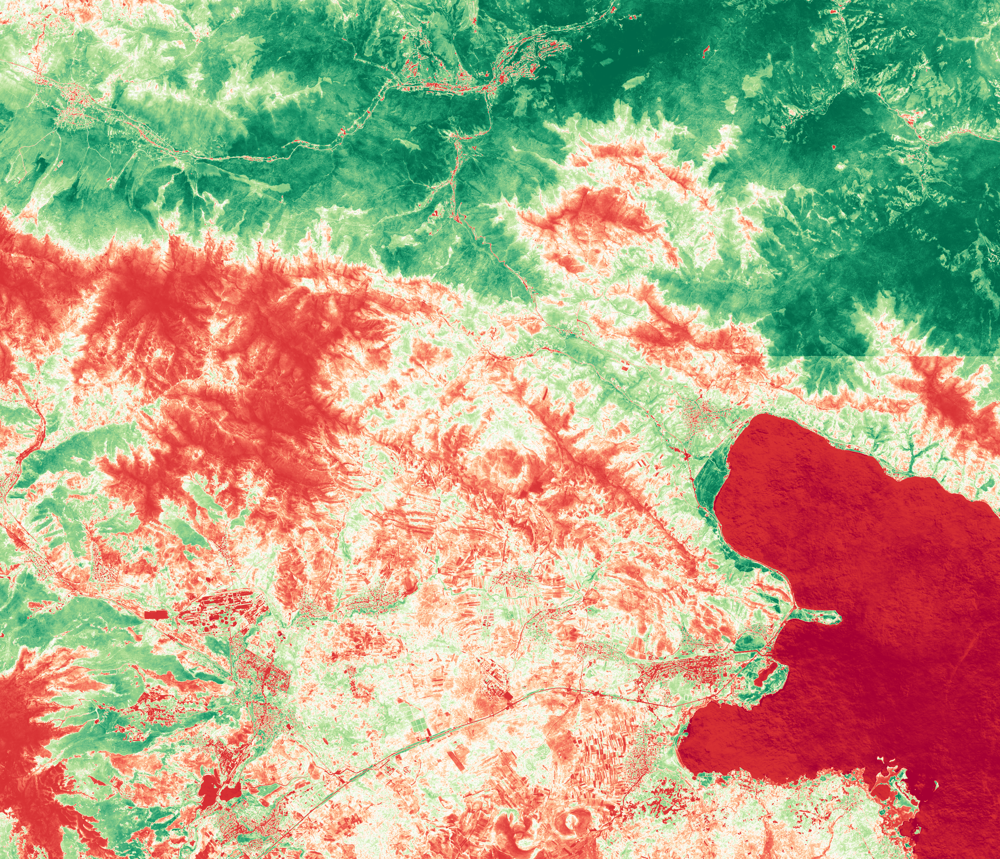

In [4]:
visualize('meta_ndvi_1699796033.json')

In [5]:
url=f'http://{ip}:81/avg/ndwi' # endpoint URL
cmap='RdBu'
body={'fire_and_forget': True,'computationURL': computationURL, 'nodes' : nodes, 'cores' : cores, 'ram' : ram, 'cmap': cmap, 'dataRepositoryURL':dataRepositoryURL, 'date_range': date_range, 'coords': {'type':'Polygon', 'coordinates': coordinates}}
response = requests.post(url, json = body)
response.text

NameError: name 'response' is not defined

In [6]:
url=f'http://{ip}:81/output/1699796255'
response = requests.get(url, json = body)

In [7]:
unzip(response)

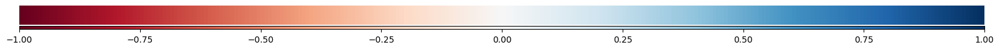

In [6]:
show_legend(cmap)


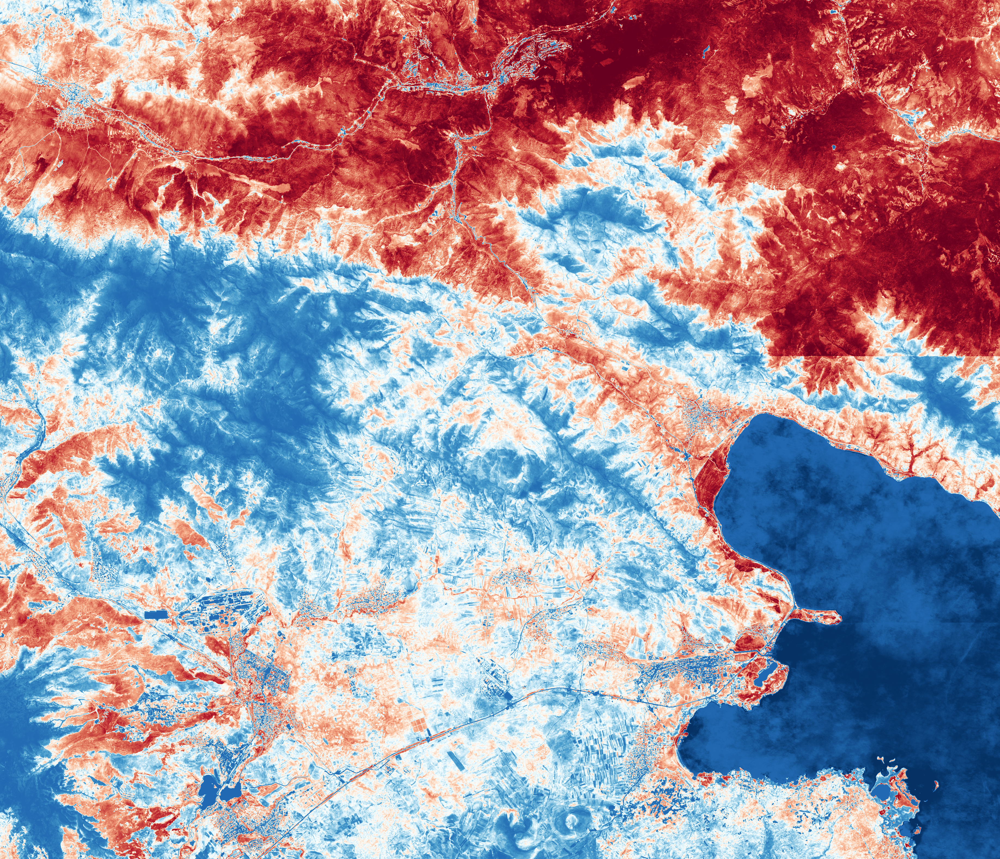

In [8]:
visualize('meta_ndwi_1699796255.json')